# 👻 Azimuth Ambiguities in SAR 👻

### 🔄 Revisiting Nyquist Sampling & Aliasing

Remember all the way back in **Lesson 1**, when we talked about the **Nyquist sampling theorem**? 📚 We mentioned that **azimuth ambiguities** are caused by aliasing. Now, we have all the tools to **close the loop**! You now understand the physics of SAR, so let’s see what it’s all about! 😎

### 📡 Phased Arrays & Grating Lobes

When working with **phased arrays**, we learned that placing antenna elements more than **half a wavelength** apart leads to **grating lobes**. This happens because the phase shifts between elements become ambiguous for signals arriving from wide angles.

Now that we know **SAR acts like a massive virtual phased array**, we can apply the same principle here too! 💪

### 🛰️ Spaceborne SAR & PRF

In the case of **spaceborne SAR**, we can’t just adjust the orbital speed of the satellite based on our whims. 🌍 So, what determines the spacing of our **virtual antenna elements** that constitue our synthetic aperture? **The Pulse Repetition Frequency (PRF).**

Now, several things limit the choice of PRF: 
- 🔧 Hardware limitations
- 🔍 Range ambiguities
- 📊 SAR mode design compromises

The essential fact remains: we **cannot set our PRF high enough** to achieve half-wavelength spacing for the virtual antenna elements. 😕


### 📏 Let's Crunch Some Numbers

- **Orbital velocity:** Approximately 7.5 km/s 🛰️  
- **Typical PRF:** About 5 kHz 🔁  

This means that the spacing of the virtual antenna elements is:

$$
\text{Spacing} = \frac{v}{\text{PRF}} \approx \frac{7500 \text{ m/s}}{5000 \text{ Hz}} = 1.2 \text{ m}
$$

That's **way more than half the wavelength**! 😱 As a result, the receive beam pattern of our **large synthetic phased array** will have some **nasty grating lobes**.

### 📡 Why It’s Not That Bad

Good news—things aren’t as bad as they might seem! 😌

In SAR, we use a **directive antenna** to **illuminate only a specific area on the ground** 🌍. That means we’re **not** transmitting or receiving the energy at each virtual element using a pattern full of nasty grating lobes.

Here’s what that means in practice:
- ✅ Most of the energy comes back from the intended imaging area.
- ⚠️ Some energy does spill into the **sidelobes** of our physical antenna, returning signals from outside the target zone. 😬
- 😵 These unintended returns can cause **artifacts** and other processing headaches.

### 🔑 The Total Beam Pattern

What really matters is that the **total beam pattern** of our SAR system is a **combination** of two things:

- The physical **transmit and receive pattern** of the radar antenna  
  → **No high grating lobes**, thanks to our brilliant radio engineers 🦸🎯  
- The **synthetic aperture receive pattern**  
  → This *does* have those nasty grating lobes 📡📡📡📡

Even if our synthetic array has big, ugly grating lobes, the **directive physical antenna beam** (with no grating lobes) helps a lot 🙌. 

The key idea is to design things so that the **first grating lobes of the synthetic array lie outside the mainlobe** of the physical beam. 

This means choosing a **high enough PRF**. 📈

Since the total received energy is based on the **product of the transmit and receive patterns**, the grating lobes of the total pattern are **heavily suppressed** ✅.  

But keep in mind—if there's a **really bright target** sitting in a sidelobe of our radar beam, it **can still sneak into the image and cause trouble** 😖.

It's exactly these returns from the grating lobes of our synthetic aperture that we call **azimuth ambiguities**! 👻

### 📌 Physical and Synthetic Antenna Beams

Below is a code snippet that illustrates the **beam of our physical radar antenna**, which we use to **illuminate the ground area we want to image**. 🌍

Additionally, we have the **beam pattern of our huge virtual antenna**, created by our **synthetic aperture**. This pattern is **extremely narrow**, representing the **full resolution we achieve in the azimuth (cross-range) dimension** of our SAR image. 📸

You can also see the **grating lobes** of this pattern, which appear because we are **not sampling at half-wavelength spacing**, but at a much lower rate. 📉

However, our **PRF is carefully chosen** so that the **grating lobes of our synthetic antenna array** appear **outside the mainlobe of our physical beam**. ✅ This ensures that most of the unwanted energy is suppressed and does not interfere significantly with the desired imaging area. 🚀



In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Physical antenna size
antenna_size = 3.2 # m
# SAR collection parameters
orbital_speed = 7.5e3 # m/s
PRF = 5e3 # Pulse repetition frequency (Hz)
collection_duration = 5 # s
sar_element_spacing = 2*orbital_speed / PRF # m
sar_antenna_size = orbital_speed * collection_duration
nb_pulses = int(collection_duration*PRF)
wavelength = 0.03 # m
d = wavelength / 2  # Half-wavelength spacing
nb_elements = int(round(antenna_size/d))
k = 2 * np.pi / wavelength  # Wavenumber

def compute_antenna_pattern(nb_elements, k, d, theta):
    # Compute the array factor
    array_factor = np.zeros_like(theta, dtype=complex)
    for n in range(nb_elements):
        phase_shift = k * d * n * np.sin(theta)  # Phase shift for each element (can you figure out where this comes from?)
        array_factor += np.cos(phase_shift) + 1j * np.sin(phase_shift) # We can use our cute phasors here as well!
    
    # Compute power pattern (normalized)
    power_pattern = np.abs(array_factor) ** 2
    power_pattern /= np.max(power_pattern)  # Normalize to max value

    return power_pattern

# Define azimuth angle range (theta) from -1.5 to 1.5 degrees
theta = np.linspace(-np.radians(1.5), np.radians(1.5), 10000)  # Convert to radians

# Compute power pattern (normalized)
power_pattern = compute_antenna_pattern(nb_elements, k, d, theta)
power_pattern_sar = compute_antenna_pattern(nb_pulses, k, sar_element_spacing, theta)
combined_pattern = power_pattern * power_pattern_sar

# Convert angles to degrees for plotting
theta_deg = np.degrees(theta)

# Plot the antenna pattern
plt.figure(figsize=(8, 5))
plt.plot(theta_deg, 10*np.log10(power_pattern), label=f"Physical Radar Pattern")
plt.plot(theta_deg, 10*np.log10(power_pattern_sar), label=f"SAR Virtual Array Pattern")
plt.plot(theta_deg, 10*np.log10(combined_pattern), label=f"Combined Pattern")
plt.xlabel("Azimuth Angle (Degrees)")
plt.ylabel("Normalized Power")
plt.title("Antenna Power Pattern")
plt.legend()
plt.grid()
plt.show()

### 💻 Simulation Time!

Let’s dive into a simulation to see these effects in action. We'll simulate a **spotlight mode acquisition**, where:

- We have **one target** located inside our **spot** that is directly illuminated by the radar beam. 🔦  
- There’s **another target** **away from the imaged area**, whose echoes leak into our data through the **sidelobes of our real antenna**. 🌪️  

Here's what to watch for:  
- The **sidelobe target** will appear in the data with **much lower amplitude** (due to being in the sidelobe).  
- Its **range changes more rapidly**, causing the **phase to change too quickly to be sampled unambiguously**. 🔄  

Let's see what happens! 🏊‍♂️

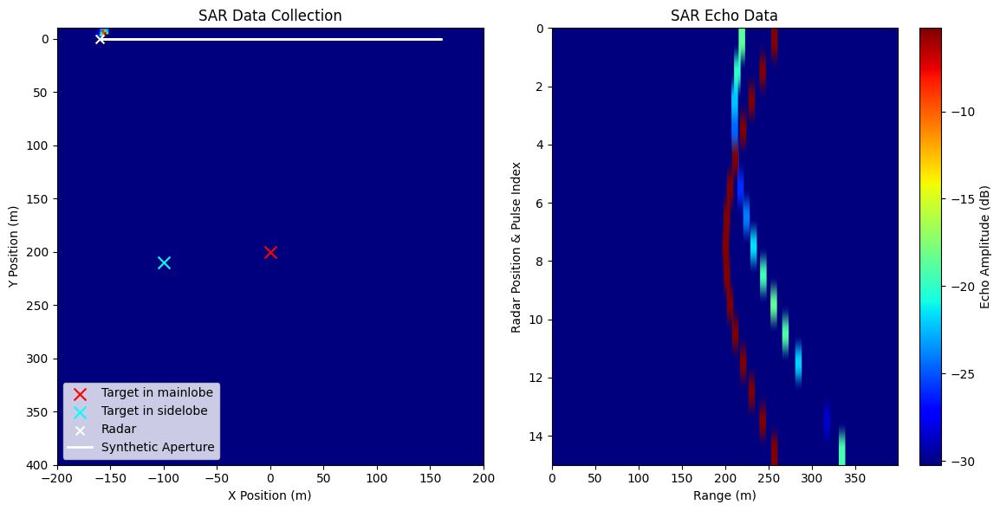

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, display

import matplotlib as mpl
mpl.rcParams['animation.embed_limit'] = 100  # set animation size limit (MB)
c = 299792458  # Speed of light (m/s)

# Simulation Parameters
beamwidth_degrees = 15  # Antenna main beam width
pulse_duration = 5e-8 # seconds
space_extent = 200 # meters, size of the area to show
grid_size = 200 # number of grid point per dimension in the plot

# We'll define "wave_frames" as how many frames to animate per pulse
wave_frames = 15   # frames per radar position
num_positions = 15  # how many radar positions (aperture steps)
total_frames = wave_frames * num_positions

# Time for pulse to fully go out and return
pulse_time = 4 * space_extent / c

# Create a meshgrid for the 2D space
x = np.linspace(-space_extent, space_extent, grid_size)
y = np.linspace(0, 2 * space_extent, grid_size)
X, Y = np.meshgrid(x, y)

# Radar & Target Configuration

# Radar flight path: Move along X at y=0
radar_x_positions = np.linspace(-0.8 * space_extent, 0.8 * space_extent, num_positions)
radar_y = 0

# Two targets, each with an amplitude
target1_x, target1_y = 0, 200
target2_x, target2_y = -100, 210
target_amplitude1 = 0.3
target_amplitude2 = 0.3

# Range/Time definitions
sampling_frequency = 10 / pulse_duration
num_range_bins = int(pulse_time * sampling_frequency)
t = np.linspace(0, pulse_time, num_range_bins, endpoint=False)
range_axis = c * t / 2

# 2D echo storage: rows = radar positions, cols = range bins
echo_data = np.zeros((num_positions, num_range_bins))

# Antenna pattern & radar pulse functions
def antenna_pattern(theta):
    """Simplified sinc antenna pattern."""
    return np.sinc(theta / np.radians(beamwidth_degrees))**2

def rect(window_t, width=1.0, center=0.0):
    """Returns a rectangular window of 'width' centered at 'center'."""
    return np.where((window_t >= center - width/2) & (window_t <= center + width/2), 1.0, 0.0)

def radar_pulse(
    R_arr,        # Range from each point in space to the radar
    R_t,          # Range from each point in space to the target
    current_time, # Current time in pulse wavefront
    pulse_dur,    # Pulse duration (s)
    target_range, # Radar→Target slant range
    amplitude,    # Target amplitude
    theta,        # Angle array for antenna pattern
):
    """
    Generates outgoing + reflected wave snapshot:
    - R_arr is distance from radar
    - R_t is distance from target
    - current_time sets how far the pulse has traveled
    - amplitude scales the reflected wave
    """
    pulse_distance = current_time * c
    pulse_width_m = pulse_dur * c

    # Outgoing pulse in free space
    wave_out = np.zeros_like(R_arr)
    in_outgoing = (R_arr > (pulse_distance - pulse_width_m/2)) & (R_arr < (pulse_distance + pulse_width_m/2))
    wave_out[in_outgoing] = 1.0

    # Reflected wave near the target
    wave_back = np.zeros_like(R_t)
    if pulse_distance >= target_range:
        leftover = pulse_distance - target_range
        in_reflect = (R_t > (leftover - pulse_width_m/2)) & (R_t < (leftover + pulse_width_m/2))
        wave_back[in_reflect] = 1.0

    # Scale by antenna pattern
    pat = antenna_pattern(theta)
    return wave_out * pat + amplitude * wave_back

# Set up Figure and Axes
fig, (ax_wave, ax_sar) = plt.subplots(1, 2, figsize=(12, 6))

# 1) Pulse propagation plot (Left)
extent = (-space_extent, space_extent, 2 * space_extent, -10)
cax_wave = ax_wave.imshow(
    np.zeros_like(X),
    extent=extent,
    cmap='jet',
    vmin=-25,
    vmax=0,
    animated=True
)
ax_wave.set_title("SAR Data Collection")
ax_wave.set_xlabel("X Position (m)")
ax_wave.set_ylabel("Y Position (m)")

# Plot the two targets
ax_wave.scatter(target1_x, target1_y, color="red", s=100, marker="x", label="Target in mainlobe")
ax_wave.scatter(target2_x, target2_y, color="cyan", s=100, marker="x", label="Target in sidelobe")

# Radar location marker
sc_radar = ax_wave.scatter([], [], color="white", s=50, marker='x', label="Radar")

# Synthetic aperture path line
line_aperture, = ax_wave.plot([], [], color='white', linewidth=2, label="Synthetic Aperture")

ax_wave.legend()

# 2) SAR Data plot (Right)
cax_sar = ax_sar.imshow(
    echo_data,
    aspect='auto',
    cmap='jet',
    extent=[range_axis[0], range_axis[-1], num_positions, 0],
    animated=True
)
ax_sar.set_title("SAR Echo Data")
ax_sar.set_xlabel("Range (m)")
ax_sar.set_ylabel("Radar Position & Pulse Index")
plt.colorbar(cax_sar, ax=ax_sar, label='Echo Amplitude (dB)')

# We'll store the path
aperture_x, aperture_y = [], []

# Animation Update Function
def update(frame):
    # Which radar position are we at?
    position_index = frame // wave_frames
    time_index = frame % wave_frames

    if position_index >= num_positions:
        return cax_wave, sc_radar, line_aperture, cax_sar

    radar_x = radar_x_positions[position_index]

    # If new position, add to aperture path
    if time_index == 0:
        aperture_x.append(radar_x)
        aperture_y.append(radar_y)
        line_aperture.set_data(aperture_x, aperture_y)

    # Distances from radar to each target
    dist_target1 = np.sqrt((radar_x - target1_x)**2 + (radar_y - target1_y)**2)
    dist_target2 = np.sqrt((radar_x - target2_x)**2 + (radar_y - target2_y)**2)

    # Radar angles for each target
    azimuth_tgt1 = np.arctan2(target1_x - radar_x, target1_y - radar_y)
    azimuth_tgt2 = np.arctan2(target2_x - radar_x, target2_y - radar_y)

    # Current time in pulse wavefront
    current_time = (time_index / (wave_frames - 1)) * pulse_time

    # Distance arrays
    R_arr = np.sqrt((X - radar_x)**2 + (Y - radar_y)**2)
    # We'll define "theta" for each point
    theta = np.arctan2(X - radar_x, Y)

    # Imaging mode logic for each target's amplitude
    # Focus on each target's azimuth
    # We'll apply an angle offset for each target in the radar_pulse calls
    # Then sum them
    az_angle1 = theta - azimuth_tgt1
    az_angle2 = theta - azimuth_tgt1
    # The amplitude for each target is 1.0 * target_amplitude (like before)
    amplitude1 = target_amplitude1
    amplitude2 = antenna_pattern(azimuth_tgt2 - azimuth_tgt1)*target_amplitude2

    # Combine pulses from both targets
    R_t1 = np.sqrt((X - target1_x)**2 + (Y - target1_y)**2)
    wave1 = radar_pulse(R_arr, R_t1, current_time, pulse_duration, dist_target1, amplitude1, az_angle1)

    R_t2 = np.sqrt((X - target2_x)**2 + (Y - target2_y)**2)
    wave2 = radar_pulse(R_arr, R_t2, current_time, pulse_duration, dist_target2, amplitude2, az_angle1)

    Z_total = wave1 + wave2

    # Update wave display
    cax_wave.set_array(10*np.log10(Z_total+1e-12))
    sc_radar.set_offsets([radar_x, radar_y])

    # After last sub-frame, record echo data
    if time_index == wave_frames - 1:
        # Combine echoes from both targets (rect function) in range space
        return_time_tgt1 = 2 * dist_target1 / c
        return_time_tgt2 = 2 * dist_target2 / c

        echo1 = amplitude1 * rect(t, pulse_duration, return_time_tgt1)
        echo2 = amplitude2 * rect(t, pulse_duration, return_time_tgt2)
        echo_data[position_index, :] = echo1 + echo2

        # Update 2D Echo
        cax_sar.set_data(10*np.log10(echo_data+1e-12))
        max_val = 10*np.log10(max(target_amplitude1, target_amplitude2))
        cax_sar.set_clim(max_val-25, max_val)

    return cax_wave, sc_radar, line_aperture, cax_sar

# Create animation
fig.tight_layout()
sar_animation = animation.FuncAnimation(
    fig, update,
    frames=total_frames,
    interval=150,
    blit=False
)

display(HTML(sar_animation.to_jshtml()))

### 📸 Generating the SAR Image

Now it’s time to simulate what the actual **SAR image** would look like in this kind of scenario.

In our **SAR beamforming**, the key steps are:  
1. **Tracing the correct range curves** for each pixel location 📈  
2. **Applying phase corrections** based on that range 🔄

But here’s the twist when we have a target sitting in a **sidelobe**:

- The **ambiguous return** from the sidelobe target causes **coherent phase addition** at certain pixel locations—just like what happens with grating lobes in a conventional array.  
- However, the **range to that sidelobe target** traces a **different curve** that doesn’t match the pixel grid. It **doesn’t align with any real pixel** in the image ⚡

🔦 As a result, the sidelobe target gets **smeared across a wide area** in the image, appearing as a **mysterious ghost signature** 👻.

Spooky!

Maximum unambiguous cross-range: 20.0 m


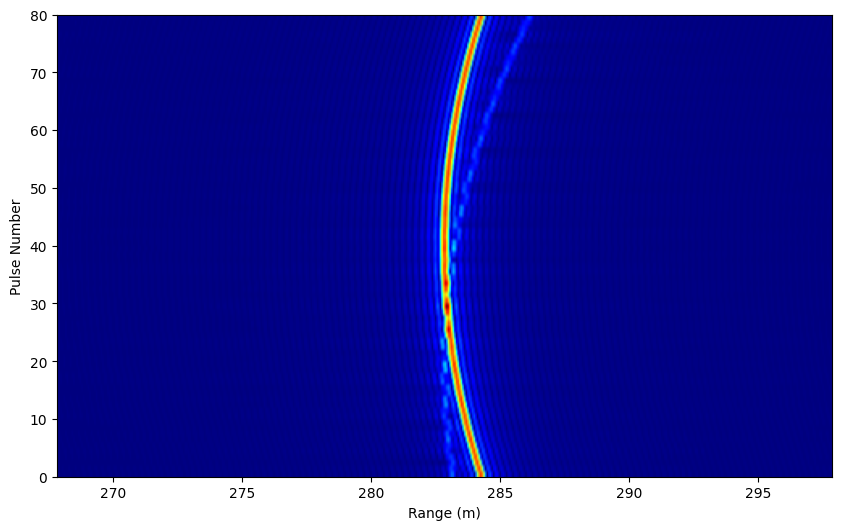

In [2]:
import numpy as np
import matplotlib.pyplot as plt
c = 299792458 # Speed of light (m/s)

# Simulation parameters
wavelength = 0.1 # m
range_resolution = 0.25 # m
cross_range_resolution = 0.25 # m

# Let's calculate how big of an aperture we need to achieve the cross-range resolution
theta_required = wavelength / (2*cross_range_resolution)

# Target locations
xyz_target_1 = [0,0,0]
xyz_target_2 = [-15,0,0]
amplitude_target_1 = 1.0
amplitude_target_2 = 0.2 # Much lower amplitude corresponds to a terget in the antenna sidelobe 

# Convert to a NumPy array of shape (N, 3)
target_coordinates = np.array([xyz_target_1, xyz_target_2])
target_amplitudes = np.array([amplitude_target_1, amplitude_target_2])

# Radar location
y_radar = 200
z_radar = 200
r0 = np.sqrt(y_radar**2 + z_radar**2)
aperture_length = theta_required * r0

# Simulate data so that the second target is in the ambiguous zone
azimuth_size = 20 # Size of the unambiguos region in cross range (m)
aperture_sample_spacing = (wavelength*r0) / (2*azimuth_size)
number_of_pulses = int(round(aperture_length / aperture_sample_spacing))

# Collect radar positions into an array
x_radar = np.linspace(-aperture_length/2, aperture_length/2, number_of_pulses)
xyz_radar = np.zeros((number_of_pulses, 3))
for i_pulse in range(number_of_pulses):
    xyz_radar[i_pulse,:] = np.array([x_radar[i_pulse], y_radar, z_radar])

print("Maximum unambiguous cross-range:", (wavelength*r0) / (2*aperture_sample_spacing), "m")

# Simulate range-compressed target echoes
range_window = 30 # m
nb_range_samples = 4*int(round(range_window / range_resolution))
range_axis = np.linspace(-range_window/2, range_window/2, nb_range_samples) + r0

range_compressed_data = np.zeros((number_of_pulses, nb_range_samples), dtype=np.complex64)
for j, target_xyz in enumerate(target_coordinates):
    for i, x_radar_pos in enumerate(x_radar):
        distance_to_target = np.sqrt( (x_radar_pos - target_xyz[0])**2 + (y_radar - target_xyz[1])**2 + (z_radar - target_xyz[2])**2 )
        # Add range-compressed target echo
        target_phasor = np.exp(1j* 2 * np.pi * 2 * distance_to_target / wavelength)
        range_compressed_data[i,:] += target_amplitudes[j] * np.sinc( (range_axis - distance_to_target) / range_resolution ) * target_phasor
        

fig, ax = plt.subplots(figsize=(10, 6))
im = ax.imshow(
    np.abs(range_compressed_data),
    extent=[range_axis[0], range_axis[-1], 0, number_of_pulses],
    aspect='auto',
    origin='lower',
    cmap='jet'
)
ax.set_xlabel("Range (m)")
ax.set_ylabel("Pulse Number")
plt.show()

SAR Beamforming Progress: 0%
SAR Beamforming Progress: 10%
SAR Beamforming Progress: 20%
SAR Beamforming Progress: 30%
SAR Beamforming Progress: 40%
SAR Beamforming Progress: 50%
SAR Beamforming Progress: 60%
SAR Beamforming Progress: 70%
SAR Beamforming Progress: 80%
SAR Beamforming Progress: 90%
SAR Beamforming Progress: 100%


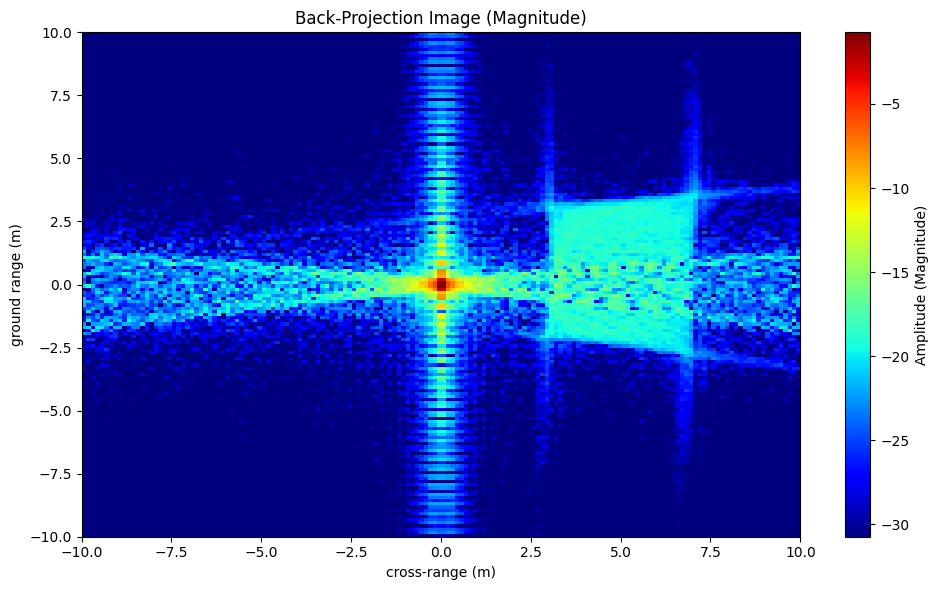

In [3]:
def sar_beamforming(range_vector, range_compressed_data_array, xyz_radar, wavelength, 
                         image_x_extent, image_y_extent, nb_pixels_x, nb_pixels_y):
    """
    Form a 2D image by time-domain delay and sum beamforming (also called back-projection)
    """
    # Number of pulses and range bins in data
    number_of_pulses = range_compressed_data_array.shape[0]
    nb_range_samples = range_compressed_data_array.shape[1]

    # Range sampling
    range_spacing = range_vector[1] - range_vector[0]  # Assume uniform spacing

    # Create output image
    image = np.zeros((nb_pixels_y, nb_pixels_x), dtype=np.complex128)

    # Define x and y pixel coordinates
    x_grid = np.linspace(x_extent[0], x_extent[-1], nb_pixels_x)
    y_grid = np.linspace(y_extent[0], y_extent[1], nb_pixels_y)

    # Loop over each pixel
    pixel_count = 0
    nb_pixels = nb_pixels_x*nb_pixels_y
    last_printed_percent = -1
    for iy, y_val in enumerate(y_grid):
        for ix, x_val in enumerate(x_grid):
            # Loop through the virutal antenna elements (pulses)
            for pulse in range(number_of_pulses):
                # Range from this radar position to the pixel
                pixel_range = np.sqrt((x_val - xyz_radar[pulse,0])**2 + (y_val - xyz_radar[pulse,1])**2 + (xyz_radar[pulse,2])**2)
                ## Find corresponding sample index (nearest neighbor)
                sample_index = int(round((pixel_range-range_vector[0])/range_spacing))
                if 0 <= sample_index < nb_range_samples:
                    # Calculate phasor to adjust the phase of the echo due to the path length difference
                    phase_correction = np.exp(-1j*2*np.pi*2*pixel_range / wavelength) 
                    # Sum the phase aligned echoes togehter
                    image[iy, ix] += range_compressed_data_array[pulse, sample_index] * phase_correction

            pixel_count += 1
            progress = int(round(100.0 * pixel_count / nb_pixels))
            # Print progress message every 10 percent, coz it's slow!
            if progress % 10 == 0 and progress != last_printed_percent:
                print(f"SAR Beamforming Progress: {progress}%")
                last_printed_percent = progress      

    image /= number_of_pulses
    return image, x_grid, y_grid


# Define image coordinates
image_x_size = 20 # m
x_extent = (-image_x_size/2, image_x_size/2)
image_y_size = 20 # m
y_extent = (-image_y_size/2, image_y_size/2)
nb_pixels_x = 2*int(image_x_size / cross_range_resolution) # Number of pixels in cross-range
nb_pixels_y = 2*int(image_x_size / cross_range_resolution) # Number of pixels in (ground) range

# Run beamforming
sar_image, x_grid, y_grid =  sar_beamforming(range_axis, range_compressed_data, xyz_radar, wavelength, 
                         image_x_size, image_y_size, nb_pixels_x, nb_pixels_y)

max_val = 10*np.log10(np.max(np.abs(sar_image)))
min_val = max_val - 30

fig, ax = plt.subplots(figsize=(10, 6))
plt.imshow(
    10*np.log10(np.abs(sar_image+1e-12)), 
    aspect='auto', 
    cmap='jet', 
    extent=[x_grid[0], x_grid[-1], y_grid[0], y_grid[-1]],
    vmin=min_val,
    vmax=max_val,
    )

plt.colorbar(label="Amplitude (Magnitude)")
plt.xlabel("cross-range (m)")
plt.ylabel("ground range (m)")
plt.title("Back-Projection Image (Magnitude)")
plt.tight_layout()
plt.show()